In [2]:
import pandas as pd
import os
pd.set_option('display.max_columns', 500)
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as numpy
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor


In [3]:
df = pd.read_csv('../../Training/X_train.csv')
y_test = pd.read_csv('../../Training/y_train.csv')
test_df = pd.read_csv('../../Test/X_test.csv')

df = df.merge(y_test, on='Unique_ID', how = 'left')

In [3]:
df.head()

,Unique_ID,C1,C2,C3,C4,C5,C6,C7,C8,N1,N2,N3,N4,N5,N6,N7,N8,N9,N10,N10.1,N11,N12,N14,N15,N16,N17,N18,N19,N20,N21,N22,N23,N24,N25,N26,N27,N28,N29,N30,N31,N32,N33,N34,N35,Dependent_Variable
0,Candidate_5926,1,0,11,31,0,False,0,True,23.75,NaN,2.5,NaN,NaN,2.595,10.0,0,0,2.0,14.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,27.816,1750.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,58.0,113.39,12.0,1
1,Candidate_48134,1,4,2,66,2,False,1,True,11.05,22.0,3.7,16.0,12.0,3.795,19.0,4,72,0.0,5.0,9.0,0.0,0.0,0.0,0.0,1944.0,0.06,25856.0,17.0,0.88,1.0,40.000,10833.333330,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,160.0,262.10,17.0,0
2,Candidate_51717,1,0,19,2,0,False,0,True,29.00,NaN,2.4,NaN,NaN,2.495,17.0,2,15,7.0,3.0,19.0,NaN,10.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.000,6250.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.0,50.29,18.0,1
3,Candidate_26401,1,1,16,47,1,False,4,True,17.99,1.0,3.5,4.0,4.0,3.595,6.0,5,190,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8244.0,0.89,1006.0,6.0,1.00,0.0,26.000,2413.666667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.0,126.52,27.0,0
4,Candidate_34872,1,1,13,1,1,True,6,True,27.50,206.0,3.8,11.0,11.0,3.895,31.0,10,1504,0.0,1.0,4.0,0.0,0.0,0.0,0.0,57532.0,0.97,3398.0,31.0,0.96,0.0,44.000,7666.666667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,205.47,21.0,0


In [4]:
df.describe()

,C1,C2,C3,C4,C5,C7,N1,N2,N3,N4,N5,N6,N7,N8,N9,N10,N10.1,N11,N12,N14,N15,N16,N17,N18,N19,N20,N21,N22,N23,N24,N25,N26,N27,N28,N29,N30,N31,N32,N33,N34,N35,Dependent_Variable
count,33050.000000,33050.000000,33050.000000,33050.000000,33050.000000,33050.000000,33050.00000,28438.000000,32685.000000,28444.000000,28444.000000,32685.000000,32623.000000,33050.000000,33050.000000,32623.000000,32623.000000,32334.000000,28436.000000,32442.000000,32623.000000,28444.000000,2.844400e+04,28444.000000,28479.000000,28479.000000,28479.000000,28479.000000,30564.000000,33050.000000,6271.000000,6271.000000,6271.000000,6271.000000,6271.000000,6271.000000,6271.000000,6220.000000,33050.000000,33050.000000,32623.000000,33050.000000
mean,1.119818,2.403873,12.856097,14.437398,1.719395,3.124932,19.97653,81.342710,3.359361,9.574075,8.350127,3.454361,25.229930,6.082723,325.585870,0.903381,2.044049,7.108678,1016.018568,4.537760,0.330135,0.023203,1.582073e+04,0.528907,11037.365322,21.764142,0.857199,0.906422,58.433363,5050.306727,1.338224,20.084197,19.512199,0.526391,0.045288,7192.813526,2379.621620,0.744373,125.629394,224.313536,19.587254,0.308805
std,0.399382,3.399024,12.013457,15.527474,1.320860,2.158905,8.11087,85.397795,0.411040,5.584756,4.999040,0.411040,14.274854,4.535870,452.149358,2.635207,3.172081,8.304500,6739.984010,10.610457,0.799125,0.175363,3.405137e+04,0.350046,22052.222523,12.438568,0.173017,1.227818,150.660621,6237.726330,0.680982,16.045120,15.637882,2.144069,0.443838,6460.139952,3379.065104,50.764684,104.391919,186.513844,7.352667,0.462007
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.095000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1000.000000,0.000000,-194.000000,20.000000,0.000000,2.000000,0.000000
25%,1.000000,0.000000,2.000000,1.000000,1.000000,1.000000,13.45000,21.000000,3.200000,6.000000,5.000000,3.295000,15.000000,3.000000,60.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,1.647000e+03,0.210000,523.000000,13.000000,0.770000,0.000000,26.000000,2833.333333,1.000000,9.000000,9.000000,0.000000,0.000000,3000.000000,0.000000,-31.000000,54.000000,98.740000,14.000000,0.000000
50%,1.000000,1.000000,10.000000,10.000000,2.000000,4.000000,19.27500,53.000000,3.400000,9.000000,8.000000,3.495000,23.000000,5.000000,183.000000,0.000000,1.000000,5.000000,0.000000,0.000000,0.000000,0.000000,6.073000e+03,0.560000,3352.000000,20.000000,0.920000,1.000000,40.000000,4166.666667,1.000000,15.000000,14.000000,0.000000,0.000000,5000.000000,1108.440000,0.000000,90.000000,172.600000,19.000000,0.000000
75%,1.000000,3.000000,20.000000,26.000000,2.000000,4.000000,26.90000,112.000000,3.600000,13.000000,11.000000,3.695000,33.000000,8.000000,420.000000,1.000000,3.000000,9.000000,0.000000,4.000000,0.000000,0.000000,1.627725e+04,0.840000,12285.000000,29.000000,1.000000,1.000000,60.000000,6250.000000,1.500000,28.000000,27.000000,0.000000,0.000000,9500.000000,3408.750000,32.000000,160.000000,300.947500,24.000000,1.000000
max,3.000000,20.000000,51.000000,67.000000,7.000000,7.000000,48.00000,755.000000,4.400000,59.000000,51.000000,4.495000,129.000000,51.000000,14985.000000,83.000000,105.000000,379.000000,444745.000000,99.000000,30.000000,7.000000,1.435667e+06,5.830000,646285.000000,114.000000,1.000000,20.000000,2002.000000,618547.833300,7.000000,120.000000,111.000000,42.000000,11.000000,60001.000000,22586.670000,257.000000,700.000000,2153.380000,64.000000,1.000000


In [5]:
df['Dependent_Variable'].value_counts()

Dependent_Variable
0    22844
1    10206
Name: count, dtype: int64

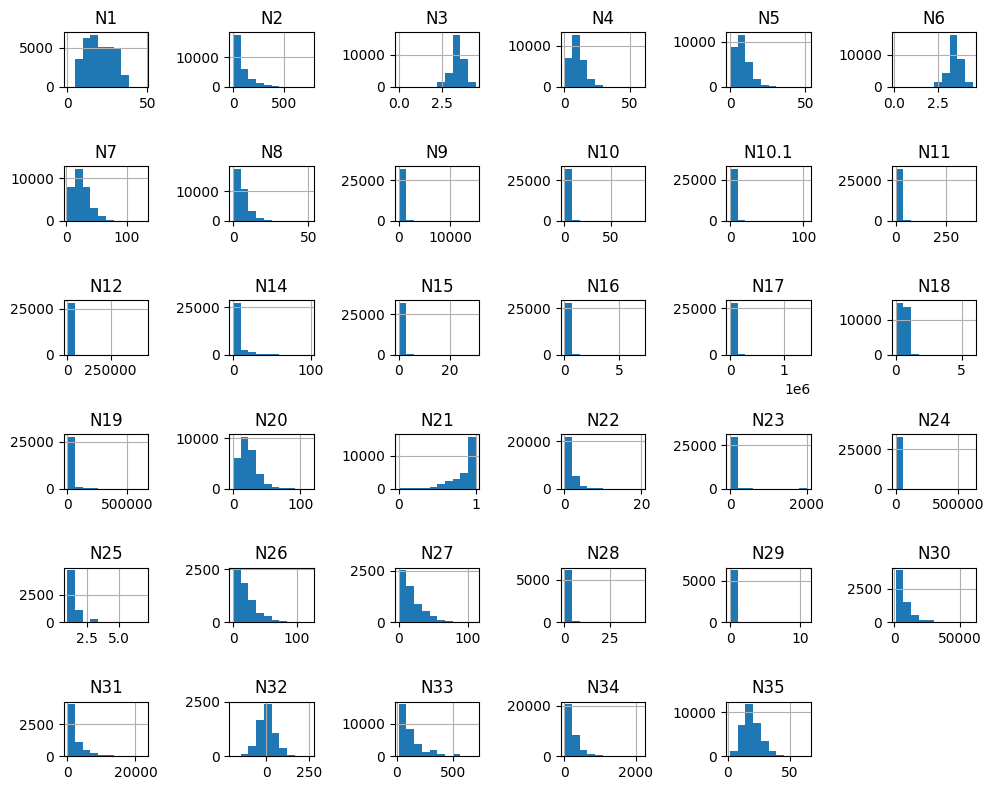

In [15]:
numerical_cols = [col for col in df.columns if col.startswith('N')]
categorical_cols = [col for col in df.columns if col.startswith('C')]

df_numerical = df[numerical_cols]
df_categorical = df[categorical_cols]
df_numerical.hist(figsize=(10, 8))
plt.tight_layout()
plt.show()




Correlation Heatmap for Numerical Columns:


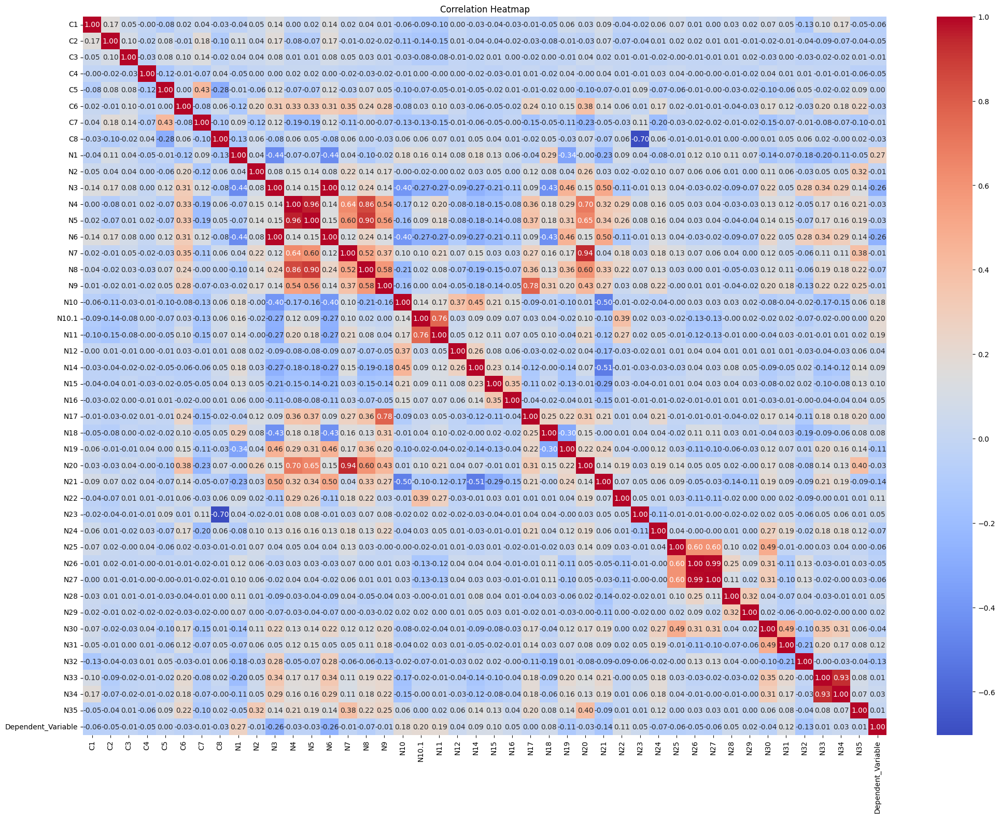

In [19]:
# Correlation heatmap for DF columns
print("\nCorrelation Heatmap for Numerical Columns:")
plt.figure(figsize=(25,18))
sns.heatmap(df.drop('Unique_ID', axis = 1).corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap')
plt.show()


Boxplots for Numerical Columns:


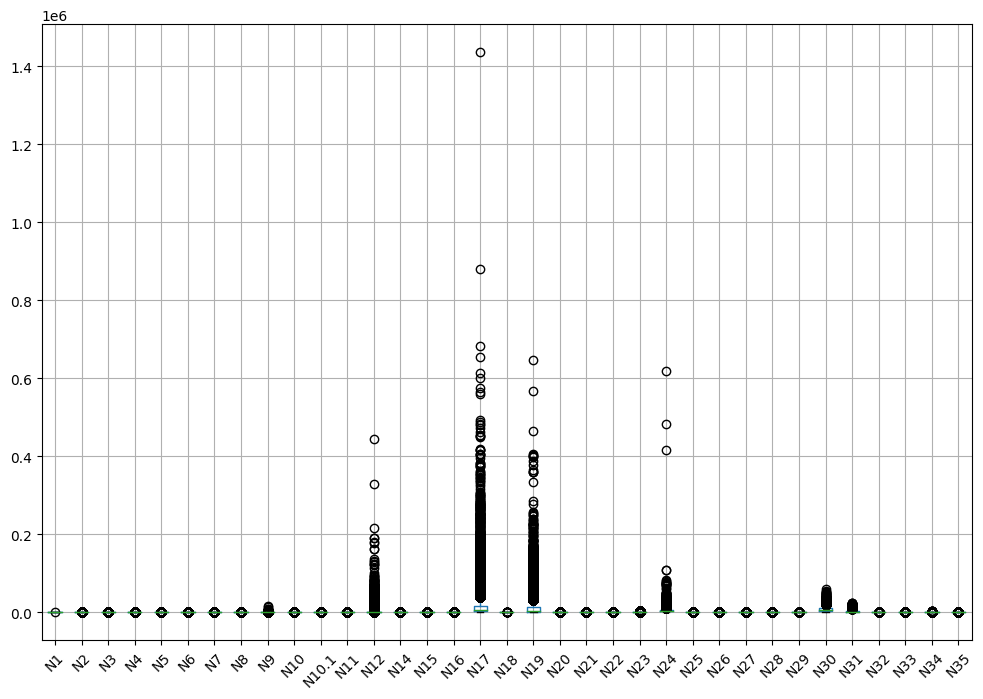

In [7]:
# Boxplots for numerical columns
print("\nBoxplots for Numerical Columns:")
plt.figure(figsize=(12, 8))
df_numerical.boxplot()
plt.xticks(rotation=45)
plt.show()


In [20]:
# Pairwise scatter plots for numerical columns
print("\nPairwise Scatter Plots for Numerical Columns:")
sns.pairplot(df_numerical)
plt.show()



Pairwise Scatter Plots for Numerical Columns:


/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be r


Violin Plots for Categorical-Numerical Relationships:


/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


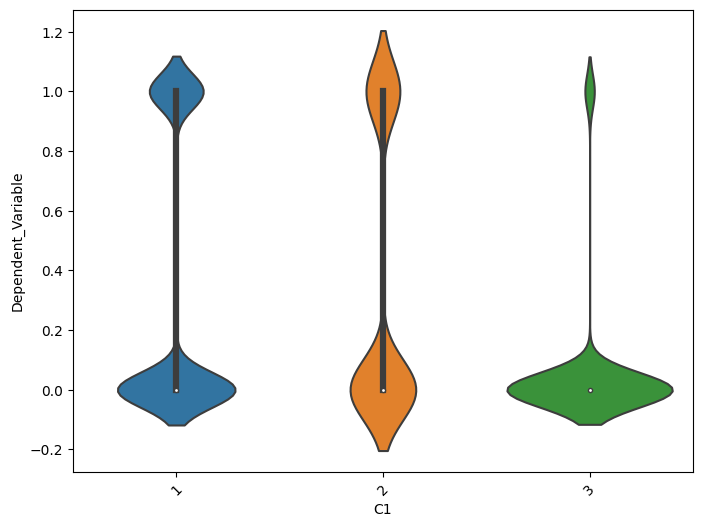

/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


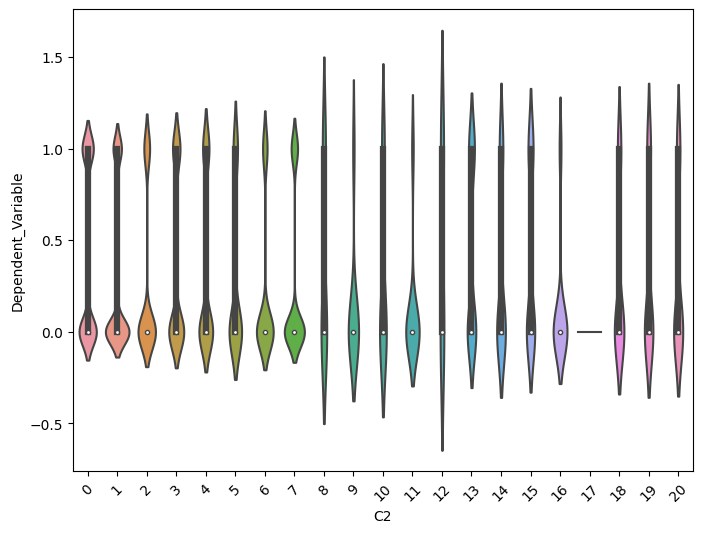

/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


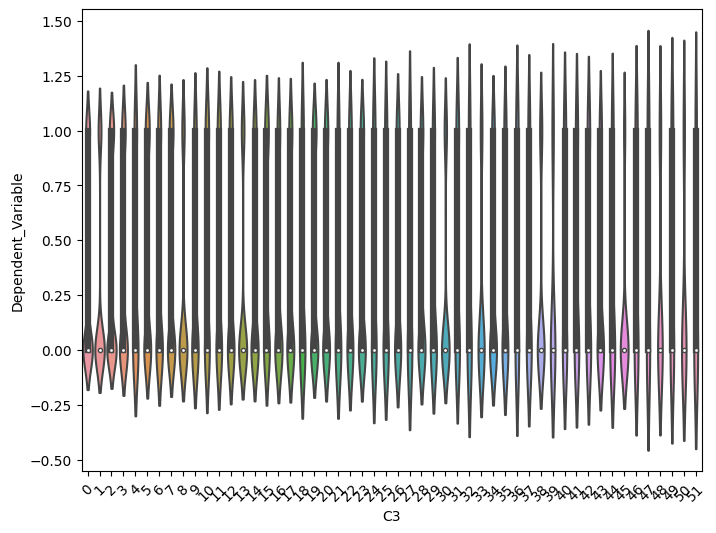

/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


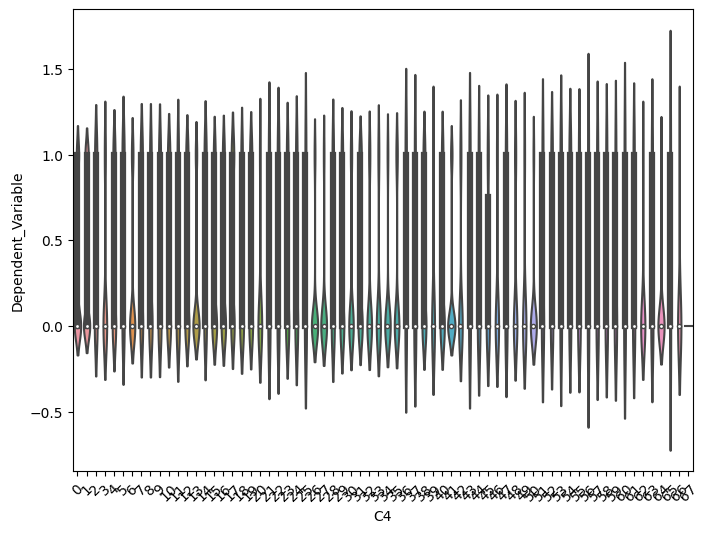

/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


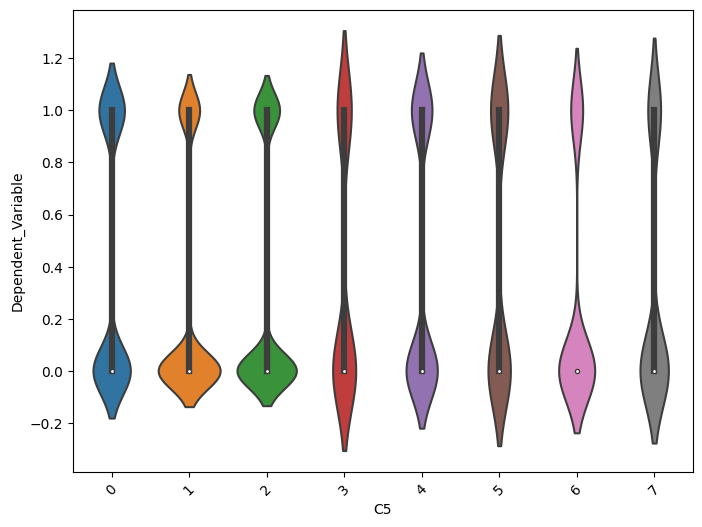

/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


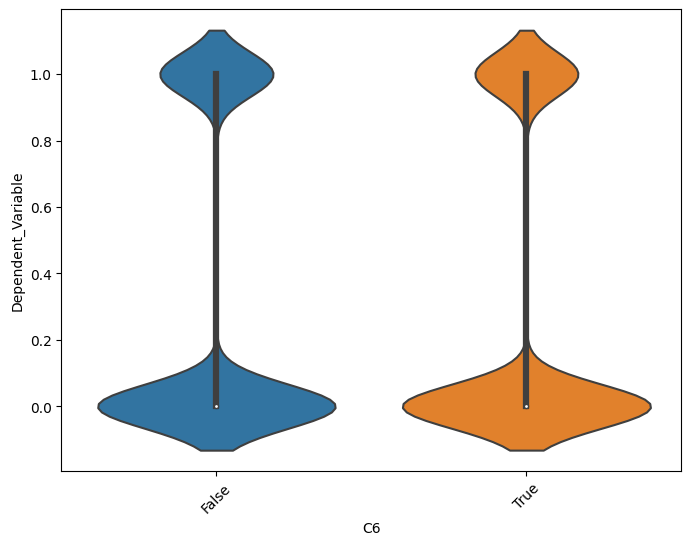

/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


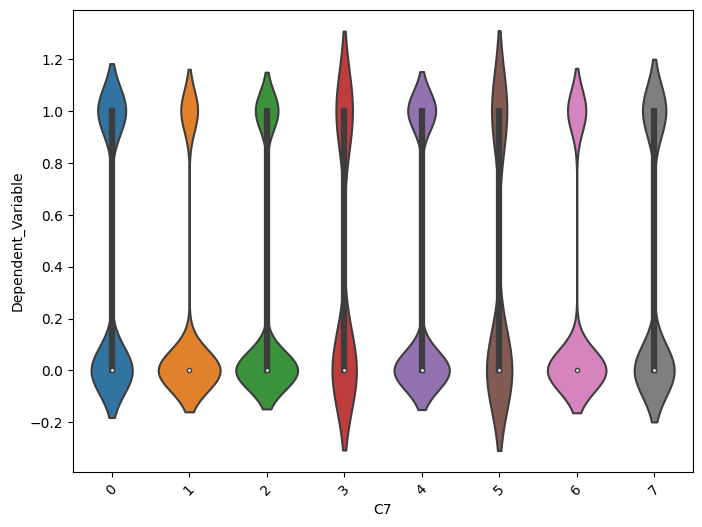

/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/rachitkumarsingh/Library/Python/3.9/lib/python/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


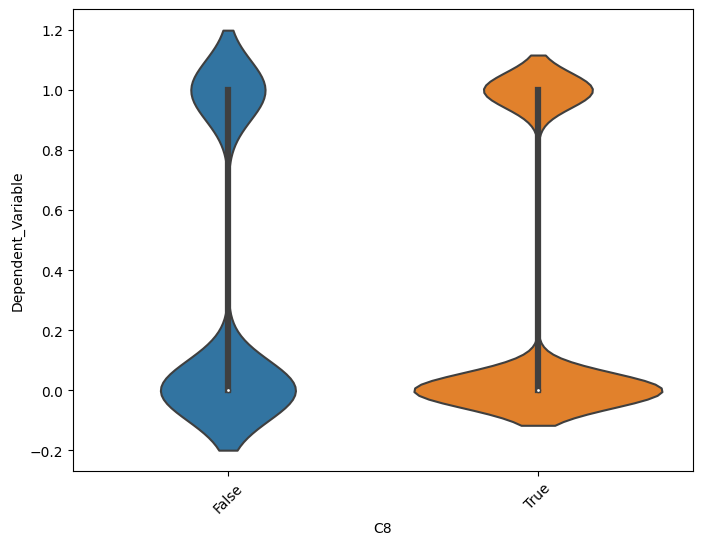

In [17]:
# Violin plots for categorical-numerical relationships
print("\nViolin Plots for Categorical-Numerical Relationships:")
for col in df_categorical.columns:
    plt.figure(figsize=(8, 6))
    sns.violinplot(data=df, x=col, y='Dependent_Variable')
    plt.xticks(rotation=45)
    plt.show()


In [10]:
df.head()

,Unique_ID,C1,C2,C3,C4,C5,C6,C7,C8,N1,N2,N3,N4,N5,N6,N7,N8,N9,N10,N10.1,N11,N12,N14,N15,N16,N17,N18,N19,N20,N21,N22,N23,N24,N25,N26,N27,N28,N29,N30,N31,N32,N33,N34,N35,Dependent_Variable
0,Candidate_5926,1,0,11,31,0,False,0,True,23.75,NaN,2.5,NaN,NaN,2.595,10.0,0,0,2.0,14.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,27.816,1750.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,58.0,113.39,12.0,1
1,Candidate_48134,1,4,2,66,2,False,1,True,11.05,22.0,3.7,16.0,12.0,3.795,19.0,4,72,0.0,5.0,9.0,0.0,0.0,0.0,0.0,1944.0,0.06,25856.0,17.0,0.88,1.0,40.000,10833.333330,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,160.0,262.10,17.0,0
2,Candidate_51717,1,0,19,2,0,False,0,True,29.00,NaN,2.4,NaN,NaN,2.495,17.0,2,15,7.0,3.0,19.0,NaN,10.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.000,6250.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.0,50.29,18.0,1
3,Candidate_26401,1,1,16,47,1,False,4,True,17.99,1.0,3.5,4.0,4.0,3.595,6.0,5,190,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8244.0,0.89,1006.0,6.0,1.00,0.0,26.000,2413.666667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.0,126.52,27.0,0
4,Candidate_34872,1,1,13,1,1,True,6,True,27.50,206.0,3.8,11.0,11.0,3.895,31.0,10,1504,0.0,1.0,4.0,0.0,0.0,0.0,0.0,57532.0,0.97,3398.0,31.0,0.96,0.0,44.000,7666.666667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,205.47,21.0,0


In [12]:
# Correlation with the target variable
print("\nCorrelation with the Target Variable:")
target_variable = 'Dependent_Variable'
correlation_with_target = df.drop('Unique_ID', axis=1).corr()[target_variable].sort_values(ascending=False)
print(correlation_with_target)



Correlation with the Target Variable:
Dependent_Variable    1.000000
N1                    0.266740
N10.1                 0.196380
N11                   0.191514
N10                   0.181699
N31                   0.121408
N22                   0.106749
N15                   0.099403
N14                   0.094152
N18                   0.075139
N28                   0.054746
N16                   0.049168
N23                   0.049059
N12                   0.038055
N34                   0.033934
N29                   0.020979
N33                   0.014044
N35                   0.010538
C5                    0.001431
N17                   0.000480
N2                   -0.005688
C7                   -0.006676
N9                   -0.006753
C3                   -0.009858
N7                   -0.014524
C8                   -0.028673
N20                  -0.031848
C6                   -0.031891
N4                   -0.033090
N5                   -0.034303
N30                  -0.040034



Pairwise Correlation Matrix:


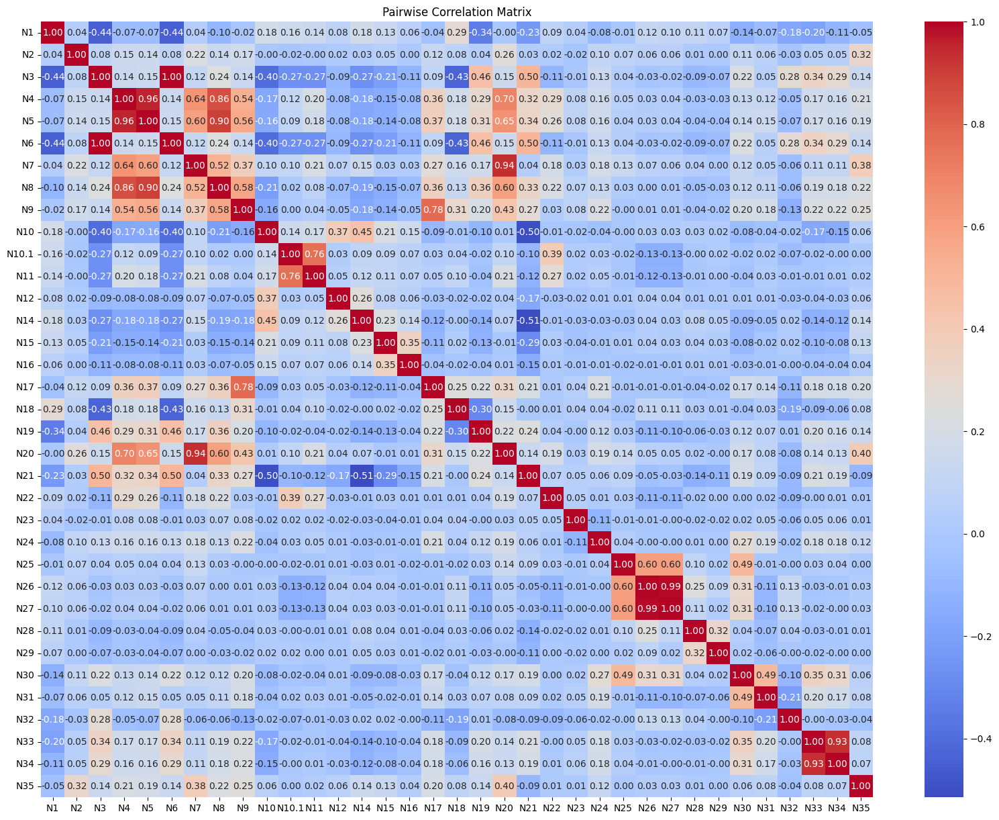

In [14]:
# Pairwise correlation matrix
print("\nPairwise Correlation Matrix:")
plt.figure(figsize=(20, 15))
sns.heatmap(df_numerical.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Pairwise Correlation Matrix')
plt.show()


In [38]:
df1 = df.fillna(df.mean())  # Fill null values with mean of the column
df1.drop('Unique_ID', axis=1, inplace = True)
# Convert boolean dtype columns to numeric
boolean_cols = df1.select_dtypes(include='bool').columns
df1[boolean_cols] = df1[boolean_cols].astype(int)

# Calculate VIF
def calculate_vif(df):
    features = df.columns
    vif_data = pd.DataFrame()
    vif_data["Features"] = features
    
    vif_data["VIF"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
    return vif_data

# Drop non-numeric columns if any
numeric_df = df1.select_dtypes(include=np.number)

# Calculate VIF
vif_result = calculate_vif(numeric_df)

vif_result

,Features,VIF
0,C1,1.152668
1,C2,1.179559
2,C3,1.055059
3,C4,1.029674
4,C5,1.434785
5,C6,1.425681
6,C7,1.485615
7,C8,1.207537
8,N1,1.599674
9,N2,1.177270


In [35]:
df1.head()

,Unique_ID,C1,C2,C3,C4,C5,C6,C7,C8,N1,N2,N3,N4,N5,N6,N7,N8,N9,N10,N10.1,N11,N12,N14,N15,N16,N17,N18,N19,N20,N21,N22,N23,N24,N25,N26,N27,N28,N29,N30,N31,N32,N33,N34,N35,Dependent_Variable
0,NaN,1,0,11,31,0,0,0,1,23.75,81.34271,2.5,9.574075,8.350127,2.595,10.0,0,0,2.0,14.0,7.108678,1016.018568,4.53776,0.0,0.023203,15820.726797,0.528907,11037.365322,21.764142,0.857199,0.906422,27.816,1750.000000,1.338224,20.084197,19.512199,0.526391,0.045288,7192.813526,2379.62162,0.744373,58.0,113.39,12.0,1
1,NaN,1,4,2,66,2,0,1,1,11.05,22.00000,3.7,16.000000,12.000000,3.795,19.0,4,72,0.0,5.0,9.000000,0.000000,0.00000,0.0,0.000000,1944.000000,0.060000,25856.000000,17.000000,0.880000,1.000000,40.000,10833.333330,1.338224,20.084197,19.512199,0.526391,0.045288,7192.813526,2379.62162,0.744373,160.0,262.10,17.0,0
2,NaN,1,0,19,2,0,0,0,1,29.00,81.34271,2.4,9.574075,8.350127,2.495,17.0,2,15,7.0,3.0,19.000000,1016.018568,10.00000,1.0,0.023203,15820.726797,0.528907,11037.365322,21.764142,0.857199,0.906422,20.000,6250.000000,1.338224,20.084197,19.512199,0.526391,0.045288,7192.813526,2379.62162,0.744373,24.0,50.29,18.0,1
3,NaN,1,1,16,47,1,0,4,1,17.99,1.00000,3.5,4.000000,4.000000,3.595,6.0,5,190,0.0,0.0,0.000000,0.000000,0.00000,0.0,0.000000,8244.000000,0.890000,1006.000000,6.000000,1.000000,0.000000,26.000,2413.666667,1.338224,20.084197,19.512199,0.526391,0.045288,7192.813526,2379.62162,0.744373,70.0,126.52,27.0,0
4,NaN,1,1,13,1,1,1,6,1,27.50,206.00000,3.8,11.000000,11.000000,3.895,31.0,10,1504,0.0,1.0,4.000000,0.000000,0.00000,0.0,0.000000,57532.000000,0.970000,3398.000000,31.000000,0.960000,0.000000,44.000,7666.666667,1.338224,20.084197,19.512199,0.526391,0.045288,7192.813526,2379.62162,0.744373,100.0,205.47,21.0,0


In [4]:
df['Dependent_Variable'].value_counts()

Dependent_Variable
0    22844
1    10206
Name: count, dtype: int64